<center>

---
# Delitos Colombia
---
</center>


In [1]:
import pandas as pd

In [2]:
df=pd.read_excel("https://github.com/Wilsonsr/metodos-estadisticos/blob/main/DelitosC.xlsx?raw=True")
df


,Departamento,Departamentos,Delitos_Sexuales,Homicidios,Transito,Asalto,Intrafamiliar,Poblacion
0,Amazonas,AMAZONAS,66,3,24,251,204,78830
1,Antioquia,ANTIOQUIA,2163,375,5079,11897,8205,6690977
2,Arauca,ARAUCA,224,43,215,790,857,270708
3,Atlantico,ATLANTICO,1042,85,1928,59,3659,2546138
4,Bogota_D.C.,SANTAFE DE BOGOTA D.C,4211,1463,725,2725,19811,8181047
5,Bolivar,BOLIVAR,944,28,922,3812,2085,2171558
6,Boyaca,BOYACA,517,95,1167,4084,2707,1281979
7,Caldas,CALDAS,443,65,1248,2243,975,993870
8,Caqueta,CAQUETA,221,18,121,654,449,496262
9,Casanare,CASANARE,260,58,602,1384,1293,375258


In [3]:
df.shape

(33, 8)

la base de datos  tiene 32 filas y 7 columnas

In [ ]:
!pip install dataprep

  Using cached Jinja2-3.0.3-py3-none-any.whl (133 kB)
  Using cached executing-0.8.3-py2.py3-none-any.whl (16 kB)
  Using cached MarkupSafe-2.1.2-cp39-cp39-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (25 kB)
  Attempting uninstall: executing
    Found existing installation: executing 1.1.1
    Not uninstalling executing at /shared-libs/python3.9/py-core/lib/python3.9/site-packages, outside environment /root/venv
    Can't uninstall 'executing'. No files were found to uninstall.
  Attempting uninstall: MarkupSafe
    Found existing installation: MarkupSafe 2.0.0
    Not uninstalling markupsafe at /shared-libs/python3.9/py-core/lib/python3.9/site-packages, outside environment /root/venv
    Can't uninstall 'MarkupSafe'. No files were found to uninstall.
  Attempting uninstall: jinja2
    Found existing installation: Jinja2 2.11.3
    Not uninstalling jinja2 at /shared-libs/python3.9/py-core/lib/python3.9/site-packages, outside environment /root/venv
    Can't uninstall 'Jinja2'. No fi

  0%|          | 0/1351 [00:00<?, ?it/s]

/root/venv/lib/python3.9/site-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/root/venv/lib/python3.9/site-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
generated new fontManager
/root/venv/lib/python3.9/site-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))


DataPrep Report
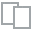
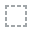
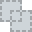
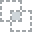
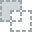
...
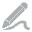
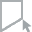
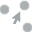
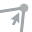
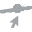

In [ ]:
from dataprep.eda import create_report
create_report(df)

vamos a pasar los delitos a tasas ya que se conoce la población de cada departamento

In [4]:
df1=pd.DataFrame()
df1["Departamentos"]=df["Departamentos"]
df1["TDS"]=(df.Delitos_Sexuales/df.Poblacion)*100000
df1["TH"]=(df.Homicidios/df.Poblacion)*100000
df1["TT"]=(df.Transito/df.Poblacion)*100000
df1["TA"]=(df.Asalto/df.Poblacion)*100000
df1["TI"]=(df.Intrafamiliar/df.Poblacion)*100000
df1

,Departamentos,TDS,TH,TT,TA,TI
0,AMAZONAS,83.724470,3.805658,30.445262,318.406698,258.784727
1,ANTIOQUIA,32.327118,5.604563,75.908197,177.806619,122.627831
2,ARAUCA,82.745985,15.884274,79.421369,291.827356,316.577271
3,ATLANTICO,40.924726,3.338389,75.722526,2.317235,143.707843
4,SANTAFE DE BOGOTA D.C,51.472629,17.882797,8.861946,33.308695,242.157269
5,BOLIVAR,43.471093,1.289397,42.457996,175.542168,96.014014
6,BOYACA,40.328274,7.410418,91.031132,318.569961,211.157905
7,CALDAS,44.573234,6.540091,125.569743,225.683439,98.101361
8,CAQUETA,44.532928,3.627116,24.382282,131.785226,90.476402
9,CASANARE,69.285665,15.456033,160.422962,368.812923,344.562941


In [5]:
df1.describe()

,TDS,TH,TT,TA,TI
count,33.000000,33.000000,33.000000,33.000000,33.000000
mean,45.771800,7.032346,81.814546,223.587321,139.703236
std,20.565581,7.378399,57.619097,128.560373,87.030108
min,0.000000,0.000000,0.000000,2.225783,4.451567
25%,30.863838,3.338389,39.844412,131.785226,90.476402
50%,43.471093,5.101195,75.908197,202.550292,123.485788
75%,55.797805,7.543037,108.491234,318.406698,169.750939
max,85.163191,39.129034,222.054599,629.997577,344.562941


In [6]:
import pandas as pd
#import numpy as np
import plotly.graph_objs as go
#import plotly.offline as pyo # para exportar en html

In [7]:
import json
from urllib.request import urlopen
with urlopen('https://gist.githubusercontent.com/john-guerra/43c7656821069d00dcbc/raw/be6a6e239cd5b5b803c6e7c2ec405b793a9064dd/Colombia.geo.json') as response:
    counties = json.load(response)

## Tasas de Homicidio

In [8]:
import pandas as pd
import requests
import plotly.express as px


fig = px.choropleth(data_frame=df1, 
                    geojson=counties, 
                    locations='Departamentos', # nombre de la columna del Dataframe
                    featureidkey='properties.NOMBRE_DPT',  # ruta al campo del archivo GeoJSON con el que se hará la relación (nombre de los estados)
                    color='TH', #El color depende de las cantidades
                    color_continuous_scale="greens", #greens
                    #scope="north america"
                   )
fig.update_geos(showcountries=False, showcoastlines=False, showland=False, fitbounds="locations")

fig.update_layout(
    title_text = 'Tasas de Homicidio',
    font=dict(
        #family="Courier New, monospace",
        family="Courier",
        size=18,
        color="#7f7f7f"
    ),
    annotations = [dict(
        x=0.55,
        y=-0.1,
        xref='paper',
        yref='paper',
        text='',
        showarrow = False
    )]
)

fig.show()


## Tasa de Delitos Sexuales

In [9]:
import pandas as pd
import requests
import plotly.express as px


fig = px.choropleth(data_frame=df1, 
                    geojson=counties, 
                    locations='Departamentos', # nombre de la columna del Dataframe
                    featureidkey='properties.NOMBRE_DPT',  # ruta al campo del archivo GeoJSON con el que se hará la relación (nombre de los estados)
                    color='TDS', #El color depende de las cantidades
                    color_continuous_scale="reds", #greens
                    #scope="north america"
                   )
fig.update_geos(showcountries=False, showcoastlines=False, showland=False, fitbounds="locations")

fig.update_layout(
    title_text = 'Tasas Delitos Sexuales x 100000 personas',
    font=dict(
        #family="Courier New, monospace",
        family="New",
        size=18,
        color="#7f7f7f"
    ),
    annotations = [dict(
        x=0.55,
        y=-0.1,
        xref='paper',
        yref='paper',
        text='',
        showarrow = False
    )]
)

fig.show()


## Tasas Asaltos

In [ ]:
import pandas as pd
import requests
import plotly.express as px


fig = px.choropleth(data_frame=df1, 
                    geojson=counties, 
                    locations='Departamentos', # nombre de la columna del Dataframe
                    featureidkey='properties.NOMBRE_DPT',  # ruta al campo del archivo GeoJSON con el que se hará la relación (nombre de los estados)
                    color='TA', #El color depende de las cantidades
                    color_continuous_scale="blues", #greens
                    #scope="north america"
                   )
fig.update_geos(showcountries=True, showcoastlines=True, showland=True, fitbounds="locations")

fig.update_layout(
    title_text = 'Tasas Asaltos x 100000 personas',
    font=dict(
        #family="Courier New, monospace",
        family="New",
        size=18,
        color="#7f7f7f"
    ),
    annotations = [dict(
        x=0.55,
        y=-0.1,
        xref='paper',
        yref='paper',
        text='',
        showarrow = False
    )]
)

fig.show()


A continuación realizaremos un agrupamientos mediante los métodos de kmeans y Agrupamiento jerarquico 

df1

In [ ]:
X=df1.loc[:,"TDS":"TI"]


In [ ]:
import matplotlib.pyplot as plt

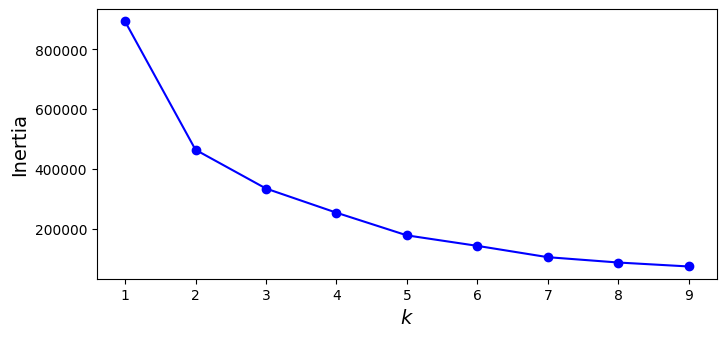

In [ ]:
from sklearn.cluster import KMeans
# Se simulan 10 modelos con diferentes k de 1 hasta 10
kmeans_per_k = [KMeans(n_clusters=k, random_state=42).fit(X)
                for k in range(1, 10)]

# Se calcula la inercia de cada uno
inertias = [model.inertia_ for model in kmeans_per_k]

# Se grafican los resultados
plt.figure(figsize=(8, 3.5))
plt.plot(range(1, 10), inertias, "bo-")
plt.xlabel("$k$", fontsize=14)
plt.ylabel("Inertia", fontsize=14)
#plt.annotate('Elbow',
#             xy=(4, inertias[3]),
#             xytext=(0.55, 0.55),
#             textcoords='figure fraction',
#             fontsize=16,
#             arrowprops=dict(facecolor='black', shrink=0.1)
#            )
#plt.axis([1, 10.5, 0, 50])
plt.show()

In [ ]:
kmeans_per_k[0].inertia_

892779.3100870049

In [ ]:
from sklearn import preprocessing 


In [ ]:
df1.columns

Index(['Departamentos', 'TDS', 'TH', 'TT', 'TA', 'TI'], dtype='object')

In [ ]:
min_max_scaler = preprocessing.MinMaxScaler() 
df_escalado = min_max_scaler.fit_transform(X)
df_escalado = pd.DataFrame(df_escalado) # Hay que convertir a DF el resultado.
df_escalado = df_escalado.rename(columns = {0: 'TDS', 1: 'TH', 2: "TT", 3:"TA", 4:"TI"})
df_escalado

,TDS,TH,TT,TA,TI
0,0.983106,0.097259,0.137107,0.503656,0.747794
1,0.379590,0.143233,0.341845,0.279689,0.347463
2,0.971617,0.405946,0.357666,0.461317,0.917716
3,0.480545,0.085317,0.341009,0.000146,0.409443
4,0.604400,0.457021,0.039909,0.049513,0.698905
5,0.510445,0.032952,0.191205,0.276082,0.269213
6,0.473541,0.189384,0.409949,0.503916,0.607761
7,0.523386,0.167142,0.565490,0.355954,0.275350
8,0.522913,0.092696,0.109803,0.206380,0.252931
9,0.813564,0.395002,0.722448,0.583950,1.000000


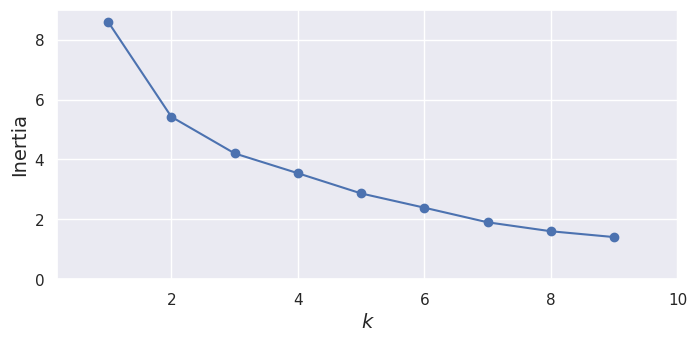

In [ ]:
from sklearn.cluster import KMeans
import seaborn as sns
sns.set_theme()
# Se simulan 10 modelos con diferentes k de 1 hasta 10
kmeans_per_k = [KMeans(n_clusters=k, random_state=42).fit(df_escalado)
                for k in range(1, 10)]

# Se calcula la inercia de cada uno
inertias = [model.inertia_ for model in kmeans_per_k]

# Se grafican los resultados
plt.figure(figsize=(8, 3.5))
plt.plot(range(1, 10), inertias, "bo-")
plt.xlabel("$k$", fontsize=14)
plt.ylabel("Inertia", fontsize=14)
#plt.annotate('Elbow',
#             xy=(4, inertias[3]),
#             xytext=(0.55, 0.55),
#             textcoords='figure fraction',
#             fontsize=16,
#             arrowprops=dict(facecolor='black', shrink=0.1)
#            )
plt.axis([0.2, 10, 0, 9])
plt.show()

### Crear modelo 

In [ ]:
## Paso 1: Definir modelo
modelo_km = KMeans(n_clusters=4, random_state=42)

# Paso 2: Ajustar
modelo_km.fit(X)



KMeans(n_clusters=4, random_state=42)

In [ ]:
modelo_km.cluster_centers_

array([[ 45.0947759 ,   7.70116761,  89.06820007, 227.7822154 ,
        106.79287849],
       [ 63.98547854,   9.54496071, 119.96931472, 330.19941921,
        238.54114663],
       [ 29.33187099,   5.10119495, 137.73226378, 629.99757693,
        300.97050234],
       [ 32.53689498,   3.89878063,  29.59669313,  76.67282673,
         88.77932445]])

In [ ]:
modelo_km.labels_

array([1, 0, 1, 3, 3, 0, 1, 0, 3, 1, 0, 0, 3, 3, 0, 0, 3, 1, 3, 0, 1, 0,
       0, 0, 1, 0, 2, 0, 0, 1, 0, 3, 3], dtype=int32)

In [ ]:
labels=modelo_km.labels_
X["labels"]=labels
X["Departamentos"]=df1["Departamentos"]
X.index=df1["Departamentos"]
X

,TDS,TH,TT,TA,TI,labels,Departamentos
Departamentos,,,,,,,
AMAZONAS,83.724470,3.805658,30.445262,318.406698,258.784727,1,AMAZONAS
ANTIOQUIA,32.327118,5.604563,75.908197,177.806619,122.627831,0,ANTIOQUIA
ARAUCA,82.745985,15.884274,79.421369,291.827356,316.577271,1,ARAUCA
ATLANTICO,40.924726,3.338389,75.722526,2.317235,143.707843,3,ATLANTICO
SANTAFE DE BOGOTA D.C,51.472629,17.882797,8.861946,33.308695,242.157269,3,SANTAFE DE BOGOTA D.C
BOLIVAR,43.471093,1.289397,42.457996,175.542168,96.014014,0,BOLIVAR
BOYACA,40.328274,7.410418,91.031132,318.569961,211.157905,1,BOYACA
CALDAS,44.573234,6.540091,125.569743,225.683439,98.101361,0,CALDAS
CAQUETA,44.532928,3.627116,24.382282,131.785226,90.476402,3,CAQUETA


In [ ]:
import pandas as pd
import requests
import plotly.express as px


fig = px.choropleth(data_frame=X, 
                    geojson=counties, 
                    locations='Departamentos', # nombre de la columna del Dataframe
                    featureidkey='properties.NOMBRE_DPT',  # ruta al campo del archivo GeoJSON con el que se hará la relación (nombre de los estados)
                    color='labels', #El color depende de las cantidades
                    #color_continuous_scale="blues", #greens
                    #scope="north america"
                   )
fig.update_geos(showcountries=False, showcoastlines=False, showland=False, fitbounds="locations")

fig.update_layout(
    title_text = 'Clusters',
    font=dict(
        #family="Courier New, monospace",
        family="New",
        size=18,
        color="#7f7f7f"
    ),
    annotations = [dict(
        x=0.55,
        y=-0.1,
        xref='paper',
        yref='paper',
        text='',
        showarrow = False
    )]
)

fig.show()


### Realicemos ahora un agrupamiento jerarquico

In [ ]:
XJ=X.loc[:,"TDS":"TI"]
XJ

,TDS,TH,TT,TA,TI
Departamentos,,,,,
AMAZONAS,83.724470,3.805658,30.445262,318.406698,258.784727
ANTIOQUIA,32.327118,5.604563,75.908197,177.806619,122.627831
ARAUCA,82.745985,15.884274,79.421369,291.827356,316.577271
ATLANTICO,40.924726,3.338389,75.722526,2.317235,143.707843
SANTAFE DE BOGOTA D.C,51.472629,17.882797,8.861946,33.308695,242.157269
BOLIVAR,43.471093,1.289397,42.457996,175.542168,96.014014
BOYACA,40.328274,7.410418,91.031132,318.569961,211.157905
CALDAS,44.573234,6.540091,125.569743,225.683439,98.101361
CAQUETA,44.532928,3.627116,24.382282,131.785226,90.476402


Text(0, 0.5, 'Euclidean distance')

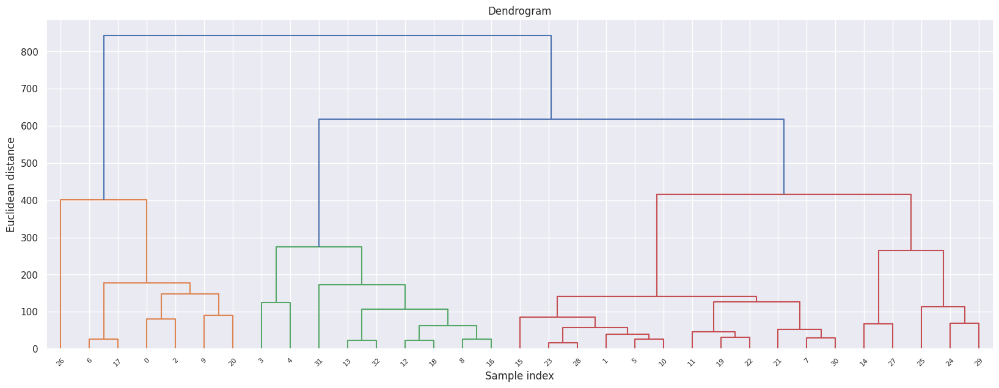

In [ ]:
import scipy.cluster.hierarchy as sc

#Dibujemos el dendograma
plt.figure(figsize=(20,7))
plt.title("Dendograma")

## Crear el dendograma
sc.dendrogram(sc.linkage(XJ, method="ward"))

plt.title('Dendrogram')
plt.xlabel('Sample index')
plt.ylabel('Euclidean distance')


In [ ]:
# Ajustemos el modelo

In [ ]:
from sklearn.cluster import AgglomerativeClustering

cluster=AgglomerativeClustering(n_clusters=3, affinity="euclidean", linkage="ward")
# Ajuste
cluster.fit(XJ)

labelsj=cluster.labels_
labelsj

array([1, 0, 1, 2, 2, 0, 1, 0, 2, 1, 0, 0, 2, 2, 0, 0, 2, 1, 2, 0, 1, 0,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 2, 2])

In [ ]:
XJ["labels"]=labelsj
XJ["Departamentos"]=XJ.index
XJ

,TDS,TH,TT,TA,TI,labels,Departamentos
Departamentos,,,,,,,
AMAZONAS,83.724470,3.805658,30.445262,318.406698,258.784727,1,AMAZONAS
ANTIOQUIA,32.327118,5.604563,75.908197,177.806619,122.627831,0,ANTIOQUIA
ARAUCA,82.745985,15.884274,79.421369,291.827356,316.577271,1,ARAUCA
ATLANTICO,40.924726,3.338389,75.722526,2.317235,143.707843,2,ATLANTICO
SANTAFE DE BOGOTA D.C,51.472629,17.882797,8.861946,33.308695,242.157269,2,SANTAFE DE BOGOTA D.C
BOLIVAR,43.471093,1.289397,42.457996,175.542168,96.014014,0,BOLIVAR
BOYACA,40.328274,7.410418,91.031132,318.569961,211.157905,1,BOYACA
CALDAS,44.573234,6.540091,125.569743,225.683439,98.101361,0,CALDAS
CAQUETA,44.532928,3.627116,24.382282,131.785226,90.476402,2,CAQUETA


In [ ]:
import pandas as pd
import requests
import plotly.express as px


fig = px.choropleth(data_frame=XJ, 
                    geojson=counties, 
                    locations='Departamentos', # nombre de la columna del Dataframe
                    featureidkey='properties.NOMBRE_DPT',  # ruta al campo del archivo GeoJSON con el que se hará la relación (nombre de los estados)
                    color='labels', #El color depende de las cantidades
                    #color_continuous_scale="blues", #greens
                    #scope="north america"
                   )
fig.update_geos(showcountries=False, showcoastlines=False, showland=False, fitbounds="locations")

fig.update_layout(
    title_text = 'Clusters',
    font=dict(
        #family="Courier New, monospace",
        family="New",
        size=18,
        color="#7f7f7f"
    ),
    annotations = [dict(
        x=0.55,
        y=-0.1,
        xref='paper',
        yref='paper',
        text='',
        showarrow = False
    )]
)


fig.show()

<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=6b01f3fd-002a-43ad-8b2f-83f22b9a4ee6' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>